In [1]:
import sys
sys.path.append('../..')

In [2]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'    # Suppress TensorFlow logging (1)
import pathlib
import tensorflow as tf
from config import PROJECT_ROOT

tf.get_logger().setLevel('ERROR')           # Suppress TensorFlow logging (2)

# Enable GPU dynamic memory allocation
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)


In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

import warnings
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings
%matplotlib inline

In [4]:
saved_model_dir = "../../alignment/efficientdet_d1_coco17_tpu-32/saved_model"
label_map_file = "../../datasets/COOP/label_map.pbtxt"

detector = tf.saved_model.load(saved_model_dir)
category_index = label_map_util.create_category_index_from_labelmap(label_map_file, use_display_name=True)

In [15]:
def inference(detector, category_index, img_path):
    # uint8 numpy array with shape (img_height, img_width, 3) for RGB
    img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(img)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    detections = detector(input_tensor)
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    # visualize output
    output_img = img.copy()
    viz_utils.visualize_boxes_and_labels_on_image_array(
          output_img,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=200,
          min_score_thresh=.30,
          agnostic_mode=False)
    return output_img

In [16]:
import os

In [11]:
test_images_dir = '../../datasets/COOP/test'

images_list = []
for image in os.listdir(test_images_dir):
    if image.endswith('.jpg'):
        image = os.path.join(test_images_dir, image)
        
        output_img, detections = inference(detector, category_index, image)

        images_list.append(output_img)
        detections_list.append(detections)

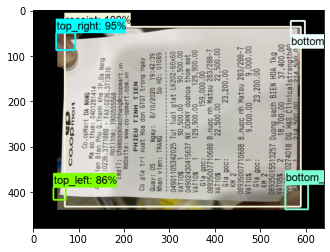

In [12]:
plt.imshow(images_list[0])
plt.show()

In [14]:
detections_list[0].keys()

dict_keys(['detection_boxes', 'detection_classes', 'raw_detection_scores', 'detection_anchor_indices', 'raw_detection_boxes', 'detection_multiclass_scores', 'detection_scores', 'num_detections'])


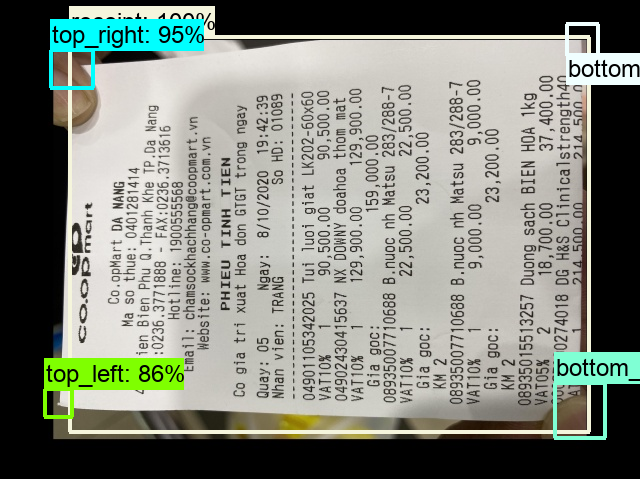
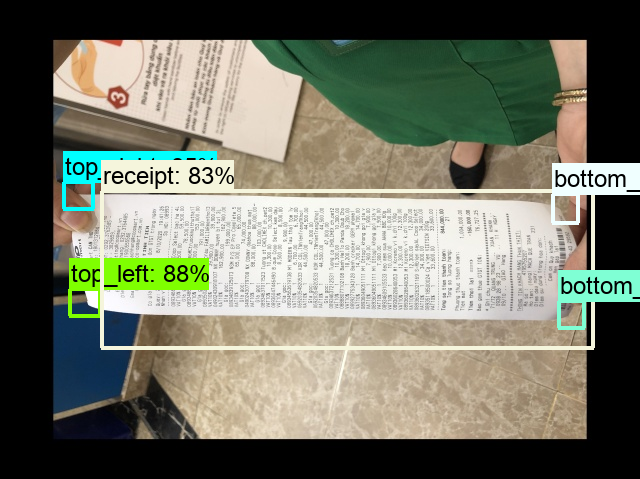
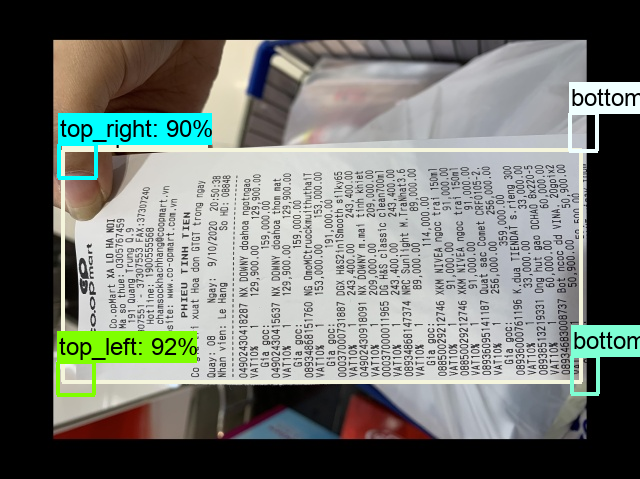
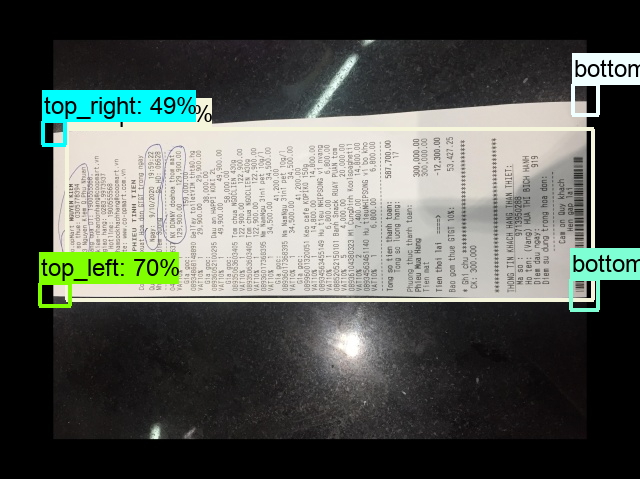
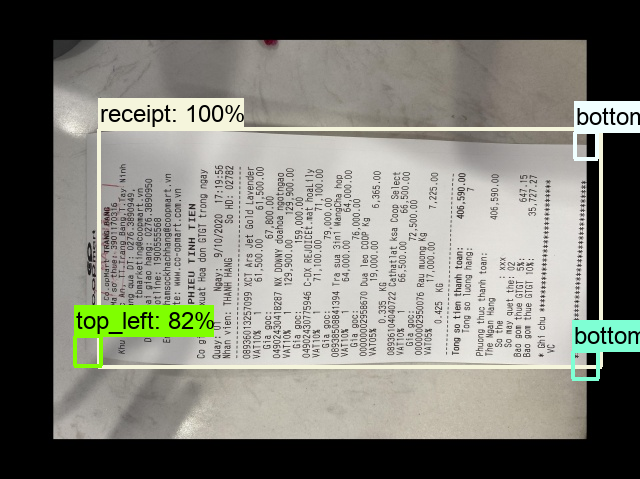
...
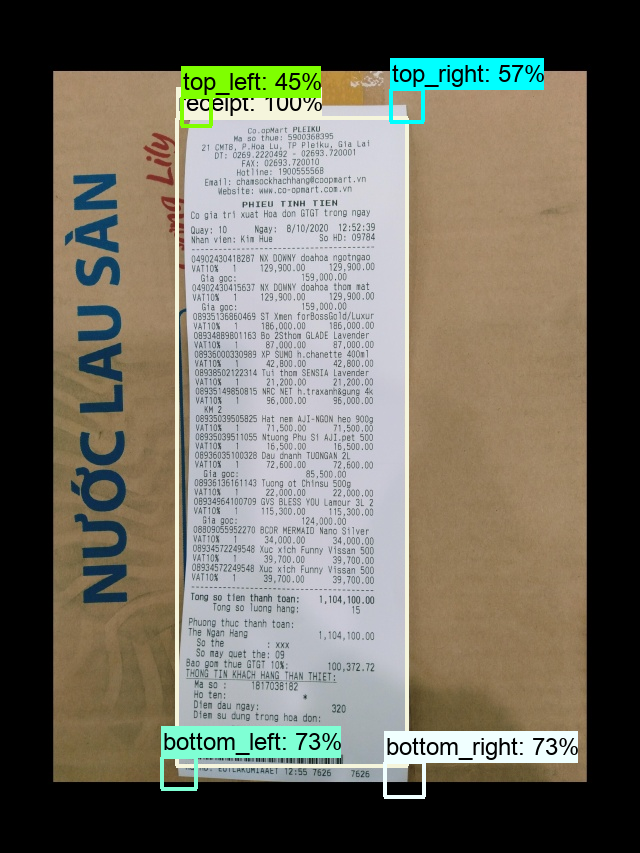
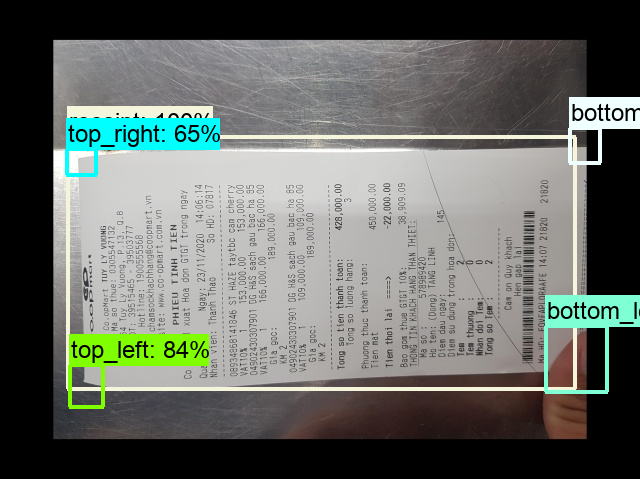
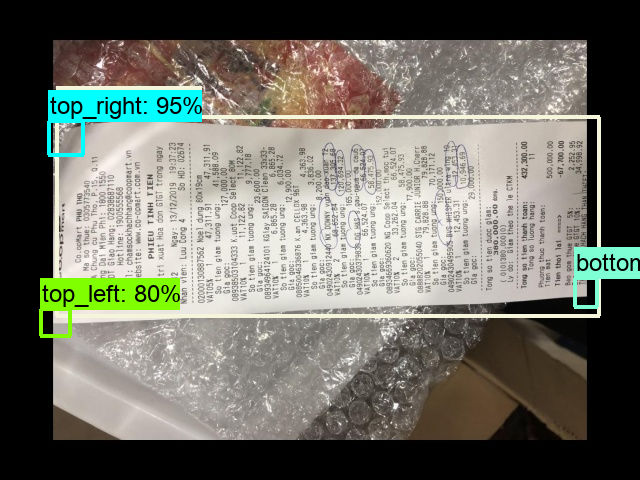
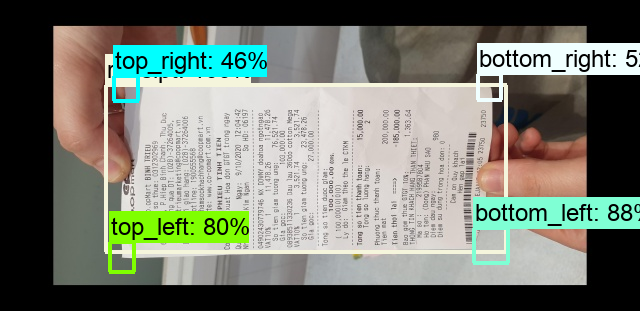
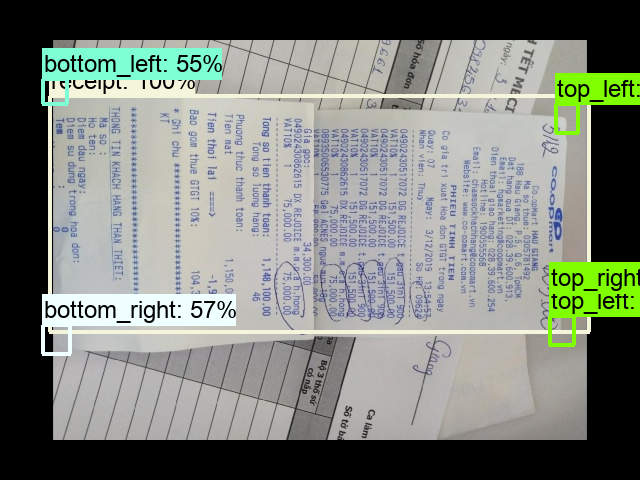

In [8]:
import ipyplot

ipyplot.plot_images(images_list, max_images=50, img_width=640)
